### KDT
#### 1. Python 데이터분석: 예측모델 개발

- 강사: 최가람, 천재교육 AI센터 데이터기획분석팀원
- 주요 업무: 이탈 예측, 추천 (도서, 콘텐츠) 모델 개발 및 운영, 데이터 분석 업무

- 일정: 2023.8.07 ~ 8.08
<p>

- 교육내용
    - <b>이탈 예측 모델 개념 및 활용 데이터 설명</b>
    - <b>데이터 전처리 모듈 개발</b>
    - <b>분석 모델링 개발 실습 1 (Logistic Regression, LGBM)</b>
    - 분석 모델링 개발 실습 2 (Logistic Regression, LGBM)
    - 성능 지표 개념 (Confusion Matrix)
    - 모델 성능 결과 분석
    - 모델 최적화
<p>

- 교육목표
    - 온라인 교육 서비스를 이용하고 있는 유저들의 이력을 바탕으로 이탈 여부를 예측할 수 있는 모델을 개발해보자
    - 통합학년 이탈 예측 모델 구성
    - 학년 별 이탈 예측 모델 구성
    - 구매/재구매 별 이탈 예측 모델 구성
    - 과제) 이탈 예측 모델 개발: 활용 데이터 간략 설명, 예측 모델(logistic, DCT, Xgboost, LGBM 등등) 구성, ** 성능 지표를 통한 결과 설명 **

#### 2. 이탈예측 데이터 분석

In [1]:
import pandas as pd
import random
import copy

import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns

In [271]:
# 데이터 읽어 오기
# 파일명: churn_data.csv
df = pd.read_csv('C:/Users/hslio/Desktop/Github/Genia/Study/data/churn_data.csv')

In [272]:
# 데이터 기본 확인 (전체 레코드 수, 컬럼명 등)
df.drop('number', axis=1, inplace=True)

컬럼 설명

- system_id	: system 상 id
- grade_sect_cd	: 학년 (1~6학년)
- mbr_sex_cd : 성별
- tmon_pchrg_lrn_dcnt : 당월 유료 학습 일 수
- acmlt_pchrg_lrn_dcnt : 누적 유료 학습 일 수 (성숙도)
- acmlt_bilclct_amt	: 누적 수금액
- correct_rate_avg	: 당월 획득 점수 평균
- learning_time_avg	: 당월 학습 시간 평균
- media_action_cnt_sum : 미디어 콘텐츠 내 동영상 행동 횟수 (총합)
- non_video_viewed_cnt_sum : 미디어 콘텐츠 미시청 행동 횟수 (총합)
- get_mm_point_sum : 당월 획득 포인트 합 (사용 x)
- label	: 이탈, 미이탈 여부 (0 - 미이탈, 1 - 이탈)
- re_purch : 구매, 재구매 여부 (False - 신규, True - 재구매)

In [273]:
df

,system_id,grade_sect_cd,mbr_sex_cd,tmon_pchrg_lrn_dcnt,acmlt_pchrg_lrn_dcnt,acmlt_bilclct_amt,correct_rate_avg,learning_time_avg,media_action_cnt_sum,non_video_viewed_cnt_sum,get_mm_point_sum,label,re_purch
0,87ee0282-ece5-4491-bb07-be93854750ac,G011,M,31.0,247.0,952000.0,0.59,670.48,673.0,306.0,1377.0,0,False
1,8817ada1-b7ad-4713-b041-ee180540cb87,G011,M,31.0,238.0,1071000.0,0.00,0.00,0.0,0.0,0.0,0,False
2,884cddf4-bda5-4d81-960c-b9a4892645f0,G011,F,31.0,92.0,436000.0,0.70,400.44,1067.0,468.0,6289.0,0,False
3,8a58832b-592b-4b33-b05e-0e11422d73d5,G011,M,31.0,370.0,1417000.0,0.81,914.47,840.0,212.0,1714.0,0,False
4,8af8f516-a9f0-4b6a-a27f-fc77ba51f708,G011,M,1.0,1.0,109000.0,0.00,0.00,0.0,0.0,0.0,0,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...
59995,3d97d2c6-50dd-4c12-9fee-01578d691b0d,G016,F,31.0,613.0,1180000.0,0.69,262.33,41.0,26.0,590.0,0,True
59996,41258431-f36d-46e7-a0d4-43f98edafd21,G016,M,31.0,62.0,178000.0,0.69,164.69,429.0,187.0,812.0,0,True
59997,4157bf9d-92ea-4656-a2f6-9ac53ced8328,G016,F,31.0,217.0,872000.0,0.43,353.55,853.0,417.0,3064.0,0,False
59998,416c8ba3-330b-45fc-aae8-91b548c28b3d,G016,M,31.0,312.0,869000.0,0.68,172.41,930.0,234.0,1092.0,0,True


In [274]:
# 컬럼 별 값 확인 (범주형)
# grade_sect_cd, mbr_sex_cd, label, re_purch
df_obj = df[['grade_sect_cd', 'mbr_sex_cd', 'label', 're_purch']]
df_obj

,grade_sect_cd,mbr_sex_cd,label,re_purch
0,G011,M,0,False
1,G011,M,0,False
2,G011,F,0,False
3,G011,M,0,False
4,G011,M,0,False
...,...,...,...,...
59995,G016,F,0,True
59996,G016,M,0,True
59997,G016,F,0,False
59998,G016,M,0,True


In [279]:
df_obj

,grade_sect_cd,mbr_sex_cd,label,re_purch
0,G011,M,0,False
1,G011,M,0,False
2,G011,F,0,False
3,G011,M,0,False
4,G011,M,0,False
...,...,...,...,...
59995,G016,F,0,True
59996,G016,M,0,True
59997,G016,F,0,False
59998,G016,M,0,True


In [ ]:
tt = ['학년 (1~6학년)', '성별', '당월 유료 학습 일 수', '누적 유료 학습 일 수 (성숙도)', '누적 수금액',
      '당월 획득 점수 평균', '당월 학습 시간 평균', '미디어 콘텐츠 내 동영상 행동 횟수 (총합)', '미디어 콘텐츠 미시청 행동 횟수 (총합)',
      '당월 획득 포인트 합 (사용 x)', '이탈, 미이탈 여부 (0 - 미이탈, 1 - 이탈)', '구매, 재구매 여부 (False - 신규, True - 재구매)']

In [281]:
cnt = -1

for a in df_obj.columns:
    cnt += 1
    tt = ['학년 (1~6학년)', '성별', '이탈, 미이탈 여부 (0 - 미이탈, 1 - 이탈)', '구매, 재구매 여부 (False - 신규, True - 재구매)']
    fig = px.histogram(df, x=a, text_auto=True, color_discrete_sequence=['chocolate'])
    fig.update_layout(bargap=0.2, title=tt[cnt])
    fig.show()

In [295]:
# 컬럼 별 값 확인 (수치형)

cnt = -1

for a in df[df.columns.difference(['grade_sect_cd', 'mbr_sex_cd', 'label', 're_purch', 'system_id'])].columns:
    cnt += 1
    tt = ['당월 유료 학습 일 수', '누적 유료 학습 일 수 (성숙도)', '누적 수금액', '당월 획득 점수 평균', 
          '당월 학습 시간 평균', '미디어 콘텐츠 내 동영상 행동 횟수 (총합)', '미디어 콘텐츠 미시청 행동 횟수 (총합)',
          '당월 획득 포인트 합 (사용 x)',]
    fig = px.box(df, x=a, color_discrete_sequence=['maroon'])
    fig.update_layout(bargap=0.2, title=tt[cnt])
    fig.show()
    print(df[a].describe())
    print()
    print('👻')

count    6.000000e+04
mean     1.251115e+06
std      7.912310e+05
min      0.000000e+00
25%      5.950000e+05
50%      1.199000e+06
75%      1.817000e+06
max      2.616000e+06
Name: acmlt_bilclct_amt, dtype: float64

👻


count    60000.000000
mean       355.340267
std        225.370258
min          0.000000
25%        169.000000
50%        344.000000
75%        532.000000
max        730.000000
Name: acmlt_pchrg_lrn_dcnt, dtype: float64

👻


count    60000.000000
mean         0.717041
std          0.203345
min          0.000000
25%          0.650000
50%          0.760000
75%          0.850000
max          1.000000
Name: correct_rate_avg, dtype: float64

👻


count    60000.000000
mean      2830.626967
std       2435.607888
min          0.000000
25%       1017.000000
50%       2145.000000
75%       4472.000000
max      66552.000000
Name: get_mm_point_sum, dtype: float64

👻


count    60000.000000
mean       410.660642
std        373.773580
min          0.000000
25%        236.735000
50%        340.335000
75%        492.200000
max      42755.000000
Name: learning_time_avg, dtype: float64

👻


count    60000.000000
mean       620.859917
std        737.375004
min          0.000000
25%        326.000000
50%        501.000000
75%        744.000000
max      45609.000000
Name: media_action_cnt_sum, dtype: float64

👻


count    60000.000000
mean       237.936550
std        153.297371
min          0.000000
25%        157.000000
50%        229.000000
75%        301.000000
max       6509.000000
Name: non_video_viewed_cnt_sum, dtype: float64

👻


count    60000.000000
mean        27.335317
std          8.584667
min          0.000000
25%         31.000000
50%         31.000000
75%         31.000000
max         31.000000
Name: tmon_pchrg_lrn_dcnt, dtype: float64

👻


In [285]:
df['tmon_pchrg_lrn_dcnt'].value_counts()

31.0    47735
0.0      2199
1.0       505
5.0       496
20.0      450
29.0      447
27.0      438
30.0      429
13.0      409
19.0      408
21.0      403
6.0       383
12.0      375
4.0       366
28.0      364
26.0      363
7.0       356
14.0      332
24.0      327
2.0       320
22.0      310
18.0      302
15.0      299
25.0      286
23.0      275
16.0      241
11.0      239
17.0      218
3.0       217
10.0      195
8.0       187
9.0       126
Name: tmon_pchrg_lrn_dcnt, dtype: int64

In [8]:
df.columns

Index(['system_id', 'grade_sect_cd', 'mbr_sex_cd', 'tmon_pchrg_lrn_dcnt',
       'acmlt_pchrg_lrn_dcnt', 'acmlt_bilclct_amt', 'correct_rate_avg',
       'learning_time_avg', 'media_action_cnt_sum', 'non_video_viewed_cnt_sum',
       'get_mm_point_sum', 'label', 're_purch'],
      dtype='object')

In [10]:
df_num = df[df.columns.difference(['grade_sect_cd', 'mbr_sex_cd', 'label', 're_purch', 'system_id'])]

In [286]:
# 전반적인 분포도 확인
import plotly.express as px

for a in df_num.columns:
    fig = px.scatter(df, x=a, y='learning_time_avg')
                    #  , y="learning_time_avg", color="grade_sect_cd", 
                    #  marginal_y="violin", marginal_x="box", 
                    #  trendline="ols", template="simple_white")
    fig.update_layout(
        font_family="D2coding")
    fig.show()

#### 3. 이탈예측 모델

[데이터 - 컨셉]
- 결과 : 이탈 or 미이탈
- 학년 이력 : 전체 학년 통합 or 학년 별 분리
- 구매, 재구매 이력: Feature 사용 or 모델 분리
- 성별 이력 등등..

[모델]
- 데이터 처리 : DB 사용 -> SQL 처리
- 모델 구현 (Logistic Regression, LGBM)
- 실행부
- 최적화 (Optimizing)

##### 3-1 데이터 전처리

In [12]:
# 데이터 읽어오기
df

,system_id,grade_sect_cd,mbr_sex_cd,tmon_pchrg_lrn_dcnt,acmlt_pchrg_lrn_dcnt,acmlt_bilclct_amt,correct_rate_avg,learning_time_avg,media_action_cnt_sum,non_video_viewed_cnt_sum,get_mm_point_sum,label,re_purch
0,87ee0282-ece5-4491-bb07-be93854750ac,G011,M,31.0,247.0,952000.0,0.59,670.48,673.0,306.0,1377.0,0,False
1,8817ada1-b7ad-4713-b041-ee180540cb87,G011,M,31.0,238.0,1071000.0,0.00,0.00,0.0,0.0,0.0,0,False
2,884cddf4-bda5-4d81-960c-b9a4892645f0,G011,F,31.0,92.0,436000.0,0.70,400.44,1067.0,468.0,6289.0,0,False
3,8a58832b-592b-4b33-b05e-0e11422d73d5,G011,M,31.0,370.0,1417000.0,0.81,914.47,840.0,212.0,1714.0,0,False
4,8af8f516-a9f0-4b6a-a27f-fc77ba51f708,G011,M,1.0,1.0,109000.0,0.00,0.00,0.0,0.0,0.0,0,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...
59995,3d97d2c6-50dd-4c12-9fee-01578d691b0d,G016,F,31.0,613.0,1180000.0,0.69,262.33,41.0,26.0,590.0,0,True
59996,41258431-f36d-46e7-a0d4-43f98edafd21,G016,M,31.0,62.0,178000.0,0.69,164.69,429.0,187.0,812.0,0,True
59997,4157bf9d-92ea-4656-a2f6-9ac53ced8328,G016,F,31.0,217.0,872000.0,0.43,353.55,853.0,417.0,3064.0,0,False
59998,416c8ba3-330b-45fc-aae8-91b548c28b3d,G016,M,31.0,312.0,869000.0,0.68,172.41,930.0,234.0,1092.0,0,True


mbr_sex_cd 컬럼 X값 전처리

In [13]:
# 'x' 제외 M, F 비율
print(len(df[df['mbr_sex_cd'] == 'M']) + len(df[df['mbr_sex_cd'] == 'F']))
print(round(len(df[df['mbr_sex_cd'] == 'M']) * 100 / (len(df[df['mbr_sex_cd'] == 'M']) + len(df[df['mbr_sex_cd'] == 'F'])),2))
print(round(len(df[df['mbr_sex_cd'] == 'F']) * 100 / (len(df[df['mbr_sex_cd'] == 'M']) + len(df[df['mbr_sex_cd'] == 'F'])),2))

58284
56.35
43.65


In [14]:
import numpy as np

In [268]:
df

,grade_sect_cd,mbr_sex_cd,tmon_pchrg_lrn_dcnt,acmlt_pchrg_lrn_dcnt,acmlt_bilclct_amt,correct_rate_avg,learning_time_avg,media_action_cnt_sum,non_video_viewed_cnt_sum,get_mm_point_sum,label,re_purch
0,1,1,31.0,247.0,952000.0,0.59,670.48,673.0,306.0,1377.0,0,0
1,1,1,31.0,238.0,1071000.0,0.00,0.00,0.0,0.0,0.0,0,0
2,1,0,31.0,92.0,436000.0,0.70,400.44,1067.0,468.0,6289.0,0,0
3,1,1,31.0,370.0,1417000.0,0.81,914.47,840.0,212.0,1714.0,0,0
4,1,1,1.0,1.0,109000.0,0.00,0.00,0.0,0.0,0.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
59995,6,0,31.0,613.0,1180000.0,0.69,262.33,41.0,26.0,590.0,0,1
59996,6,1,31.0,62.0,178000.0,0.69,164.69,429.0,187.0,812.0,0,1
59997,6,0,31.0,217.0,872000.0,0.43,353.55,853.0,417.0,3064.0,0,0
59998,6,1,31.0,312.0,869000.0,0.68,172.41,930.0,234.0,1092.0,0,1


In [266]:
# 'mbr_sex_cd' 컬럼 'x' NaN으로 대체 후 6:4 로 남, 여 채우기
df = df.replace('X', np.NaN)   # To NaN

no_sex_index = list(df[df['mbr_sex_cd'].isnull()].index)                  # NaN 값 index 
sel_ran_index = random.sample(no_sex_index, k=int(len(no_sex_index)*0.6)) # NaN 값의 60% 선택

df.loc[sel_ran_index][['mbr_sex_cd']] = df.loc[sel_ran_index][['mbr_sex_cd']].fillna('M') 
df['mbr_sex_cd'] = df['mbr_sex_cd'].fillna('F')

mbr_sex_cd
1             32843
0             25441
2              1716
dtype: int64


<Axes: xlabel='mbr_sex_cd', ylabel='Count'>

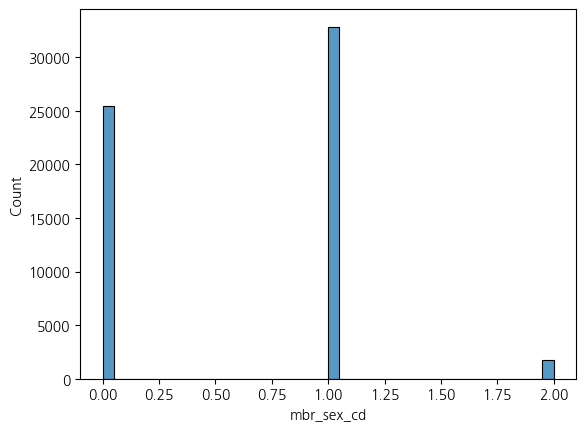

In [267]:
print(df[['mbr_sex_cd']].value_counts())
display(sns.histplot(df['mbr_sex_cd']))

In [17]:
from sklearn.preprocessing import LabelEncoder

In [18]:
df_m = copy.deepcopy(df)

In [31]:
# 학습 데이터, 레이블 (label) 분리
df_m = df.drop('system_id', axis=1)

# 'grade_sect_cd' 값 -> 1, 2, 3, 4, 5, 6 으로 치환 -> 'grade' 컬럼 구성
encoder = LabelEncoder()
df_m['grade_sect_cd'] = encoder.fit_transform(df_m['grade_sect_cd'])
df_m['mbr_sex_cd'] = encoder.fit_transform(df_m['mbr_sex_cd'])
df_m['re_purch'] = df_m['re_purch'].replace({False : 0, True : 1})

# 필요 컬럼만 가져오기 (X : 학습 데이터, y: 레이블)

X = df_m.drop('label', axis=1)
y = df_m.label

In [33]:
# Train, Test 데이터 분리 (이탈 미이탈 값 확인)
from sklearn.model_selection import train_test_split

In [81]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=77)

##### 3-2 Logistic regression 모델

In [82]:
from sklearn.linear_model import LogisticRegression
# Logistic 모델 학습

lr = LogisticRegression()
lr.fit(X_train, y_train)

c:\Users\hslio\.conda\envs\lhs\Lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



LogisticRegression()

In [83]:
# 예측 및 결과
lr_pred = lr.predict(X_test)
lr_pred

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

test
0    11819
1      181
Name: test, dtype: int64
pred
0    11945
1       55
Name: pred, dtype: int64


<Axes: ylabel='Count'>

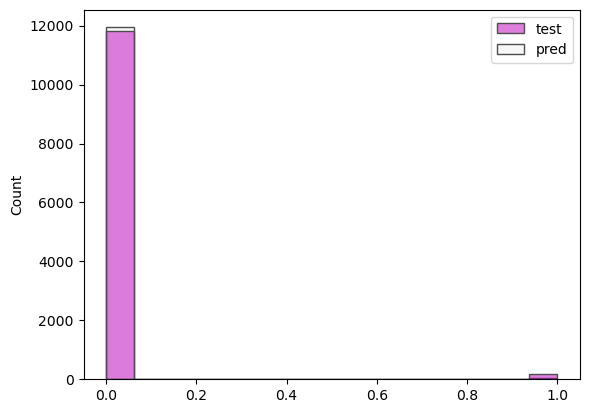

In [86]:
lr_result = pd.DataFrame({'test' : y_test, 'pred' : lr_pred})
for i in lr_result.columns:
    print(i)
    print(lr_result[i].value_counts())
sns.histplot(lr_result, palette="light:m_r", edgecolor=".3")

In [51]:
pd.DataFrame(lr_pred).value_counts()

0    12000
dtype: int64

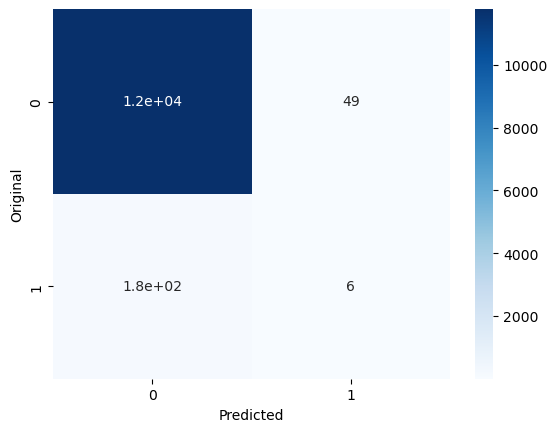

In [93]:
# 예측 데이터와 실제 데이터의 차이 살펴보기 (True or False)
from sklearn.metrics import confusion_matrix

cm = confusion_matrix(y_test, lr_pred)
sns.heatmap(cm, annot=True, cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('Original')
plt.show()

In [87]:
# Accuracy 측정
from sklearn.metrics import accuracy_score

print('\33[91m' + 'LogisticRegression' + '\033[0m')
accuracy = accuracy_score(y_test, lr_pred)
print("Accuracy:", accuracy)
print()

LogisticRegression
Accuracy: 0.9813333333333333



In [88]:
# precision, recall, f1 score 측정
from sklearn.metrics import precision_recall_fscore_support
precision_recall_fscore_support(y_test, lr_pred, average='binary')

(0.10909090909090909, 0.03314917127071823, 0.050847457627118633, None)

##### 3-3 LGBM 모델

In [ ]:
# Train, Test 데이터 분리
from sklearn.model_selection import train_test_split

In [97]:
# LGBM 모델 학습
from lightgbm import LGBMClassifier

lgb = LGBMClassifier(random_state=7, verbose=1)
lgb.fit(X_train, y_train)

[LightGBM] [Info] Number of positive: 751, number of negative: 47249
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000938 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1654
[LightGBM] [Info] Number of data points in the train set: 48000, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.015646 -> initscore=-4.141781
[LightGBM] [Info] Start training from score -4.141781


LGBMClassifier(random_state=7, verbose=1)

In [98]:
# 예측 결과
lgb_pred = lgb.predict(X_test)
lgb_pred

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

test
0    11819
1      181
Name: test, dtype: int64
pred
0    11837
1      163
Name: pred, dtype: int64


<Axes: ylabel='Count'>

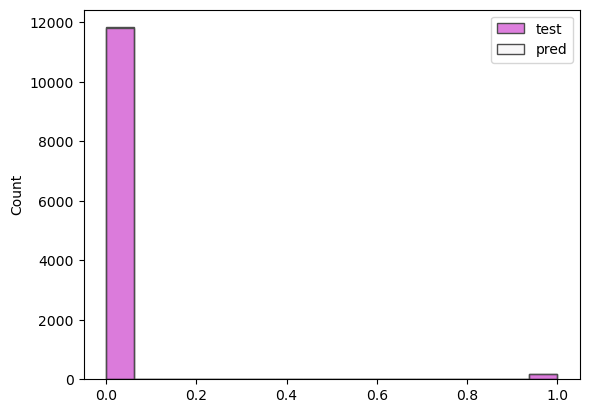

In [99]:
lgb_result = pd.DataFrame({'test' : y_test, 'pred' : lgb_pred})
for i in lgb_result.columns:
    print(i)
    print(lgb_result[i].value_counts())
sns.histplot(lgb_result, palette="light:m_r", edgecolor=".3")

In [100]:
# Accuracy 측정
from sklearn.metrics import accuracy_score

print('\33[91m' + 'LightGBM' + '\033[0m')
accuracy = accuracy_score(y_test, lgb_pred)
print("Accuracy:", accuracy)
print()

LightGBM
Accuracy: 0.9951666666666666



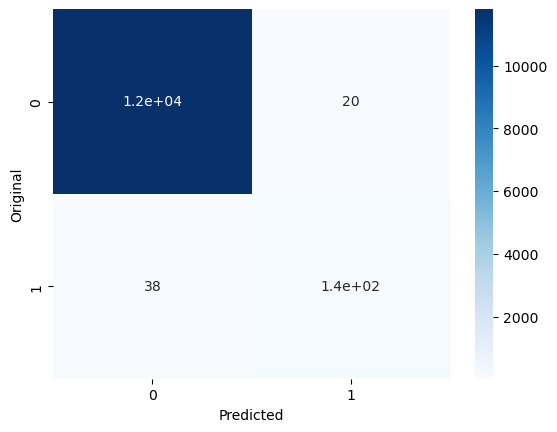

In [101]:
# 예측 데이터와 실제 데이터의 차이 살펴보기 (True or False)
from sklearn.metrics import confusion_matrix

cm = confusion_matrix(y_test, lgb_pred)
sns.heatmap(cm, annot=True, cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('Original')
plt.show()

In [102]:
# precision, recall, f1 score 측정
from sklearn.metrics import precision_recall_fscore_support
precision_recall_fscore_support(y_test, lr_pred, average='binary')

(0.10909090909090909, 0.03314917127071823, 0.050847457627118633, None)

In [ ]:
# Logistic LGBM precision, recall, f1 score 비교

<Axes: title={'center': 'Feature importance'}, xlabel='Feature importance', ylabel='Features'>

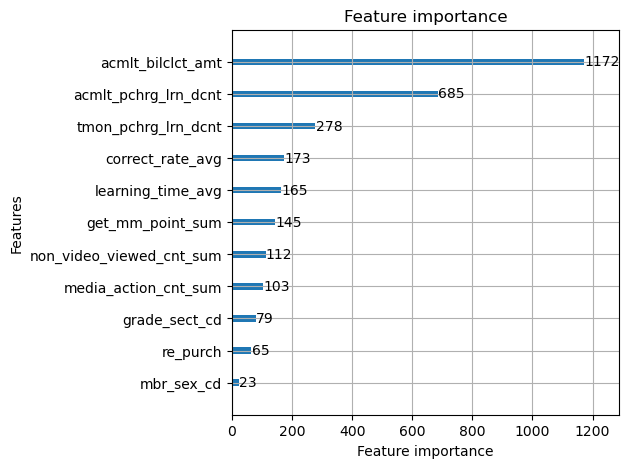

In [103]:
# 영향도 (주요 변수 시각화)
from lightgbm import plot_importance
import matplotlib.pyplot as plt
%matplotlib inline

fig, ax = plt.subplots(figsize=(5, 5))
plot_importance(lgb, ax=ax)

#### 실습 : 학년 별로 이탈 예측 모델을 구성해본 뒤, 성능 결과를 확인해 보자

In [116]:
import pandas as pd

from sklearn.model_selection import train_test_split
from lightgbm import LGBMClassifier
from sklearn.metrics import accuracy_score
from lightgbm import plot_importance
import matplotlib.pyplot as plt

In [109]:
# 데이터 읽어 오기
# 파일명: churn_data.csv
df = pd.read_csv('C:/Users/hslio/Desktop/Github/Genia/Study/data/churn_data.csv')
# 데이터 기본 확인 (전체 레코드 수, 컬럼명 등)
df.drop(['number','system_id'], axis=1, inplace=True)

In [ ]:
# 'mbr_sex_cd' 컬럼 'x' NaN으로 대체 후 6:4 로 남, 여 채우기
df = df.replace('X', np.NaN)   # To NaN

no_sex_index = list(df[df['mbr_sex_cd'].isnull()].index)                  # NaN 값 index 
sel_ran_index = random.sample(no_sex_index, k=int(len(no_sex_index)*0.6)) # NaN 값의 60% 선택

df.loc[sel_ran_index][['mbr_sex_cd']] = df.loc[sel_ran_index][['mbr_sex_cd']].fillna('M') 
df['mbr_sex_cd'] = df['mbr_sex_cd'].fillna('F')

mbr_sex_cd
1             32843
0             25441
2              1716
dtype: int64


<Axes: xlabel='mbr_sex_cd', ylabel='Count'>

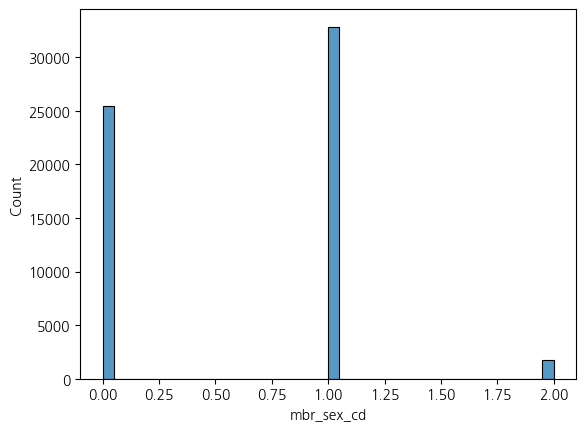

In [ ]:
print(df[['mbr_sex_cd']].value_counts())
display(sns.histplot(df['mbr_sex_cd']))

In [110]:
df

,grade_sect_cd,mbr_sex_cd,tmon_pchrg_lrn_dcnt,acmlt_pchrg_lrn_dcnt,acmlt_bilclct_amt,correct_rate_avg,learning_time_avg,media_action_cnt_sum,non_video_viewed_cnt_sum,get_mm_point_sum,label,re_purch
0,G011,M,31.0,247.0,952000.0,0.59,670.48,673.0,306.0,1377.0,0,False
1,G011,M,31.0,238.0,1071000.0,0.00,0.00,0.0,0.0,0.0,0,False
2,G011,F,31.0,92.0,436000.0,0.70,400.44,1067.0,468.0,6289.0,0,False
3,G011,M,31.0,370.0,1417000.0,0.81,914.47,840.0,212.0,1714.0,0,False
4,G011,M,1.0,1.0,109000.0,0.00,0.00,0.0,0.0,0.0,0,False
...,...,...,...,...,...,...,...,...,...,...,...,...
59995,G016,F,31.0,613.0,1180000.0,0.69,262.33,41.0,26.0,590.0,0,True
59996,G016,M,31.0,62.0,178000.0,0.69,164.69,429.0,187.0,812.0,0,True
59997,G016,F,31.0,217.0,872000.0,0.43,353.55,853.0,417.0,3064.0,0,False
59998,G016,M,31.0,312.0,869000.0,0.68,172.41,930.0,234.0,1092.0,0,True


In [120]:
# 학년 치환 (숫자로)
df['grade_sect_cd'] = df['grade_sect_cd'].replace({'G011': 1, 'G012': 2, 'G013': 3,
                                                   'G014': 4, 'G015': 5,'G016': 6})
df['re_purch'] = df['re_purch'].replace({False: 0, True : 1})

In [121]:
df

,grade_sect_cd,mbr_sex_cd,tmon_pchrg_lrn_dcnt,acmlt_pchrg_lrn_dcnt,acmlt_bilclct_amt,correct_rate_avg,learning_time_avg,media_action_cnt_sum,non_video_viewed_cnt_sum,get_mm_point_sum,label,re_purch
0,1,M,31.0,247.0,952000.0,0.59,670.48,673.0,306.0,1377.0,0,0
1,1,M,31.0,238.0,1071000.0,0.00,0.00,0.0,0.0,0.0,0,0
2,1,F,31.0,92.0,436000.0,0.70,400.44,1067.0,468.0,6289.0,0,0
3,1,M,31.0,370.0,1417000.0,0.81,914.47,840.0,212.0,1714.0,0,0
4,1,M,1.0,1.0,109000.0,0.00,0.00,0.0,0.0,0.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
59995,6,F,31.0,613.0,1180000.0,0.69,262.33,41.0,26.0,590.0,0,1
59996,6,M,31.0,62.0,178000.0,0.69,164.69,429.0,187.0,812.0,0,1
59997,6,F,31.0,217.0,872000.0,0.43,353.55,853.0,417.0,3064.0,0,0
59998,6,M,31.0,312.0,869000.0,0.68,172.41,930.0,234.0,1092.0,0,1


In [122]:
from sklearn.preprocessing import LabelEncoder

encoder = LabelEncoder()
df['mbr_sex_cd'] = encoder.fit_transform(df['mbr_sex_cd'])

In [168]:
df_obj

,grade_sect_cd,mbr_sex_cd,label,re_purch
0,G011,M,0,False
1,G011,M,0,False
2,G011,F,0,False
3,G011,M,0,False
4,G011,M,0,False
...,...,...,...,...
59995,G016,F,0,True
59996,G016,M,0,True
59997,G016,F,0,False
59998,G016,M,0,True


In [205]:
def grade_model(df, grade_name = 1):
    X = df[['mbr_sex_cd', 
           'tmon_pchrg_lrn_dcnt',
           'acmlt_pchrg_lrn_dcnt', 
           'acmlt_bilclct_amt', 
           'correct_rate_avg',
           'learning_time_avg', 
           'media_action_cnt_sum', 
           'non_video_viewed_cnt_sum',
           'get_mm_point_sum', 
           're_purch']]
    y = df['label']

    # Train, Test 데이터 분리
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=777)
    print('[Train] {}학년, 이탈: {}, 미이탈: {}'.format(grade_name, y_train[y_train==1].shape[0], y_train[y_train==0].shape[0]))
    print('[Test] {}학년, 이탈: {}, 미이탈: {}'.format(grade_name, y_test[y_test==1].shape[0], y_test[y_test==0].shape[0]))

    lgbm_model = LGBMClassifier(random_state=7, verbose=-1)
    lgbm_model.fit(X_train, y_train)

    y_pred = lgbm_model.predict(X_test)
    y_pred = list(y_pred)
    print('[Predict] {}학년, 이탈: {}, 미이탈: {}'.format(grade_name, y_pred.count(1), y_pred.count(0)))

    # Accuracy
    acc = accuracy_score(y_test, y_pred)

    # Precision, recall, f1
    pre, re, f1, _ = precision_recall_fscore_support(y_test, y_pred, average='binary')
    print('{}학년, acc: {}, precision: {}, recall: {}, f1: {}'.format(grade_name, acc, pre, re, f1))

    # 주요 변수 시각화
    fig, ax = plt.subplots(figsize=(5,5))
    plot_importance(lgbm_model, ax=ax)
    plt.title('{}학년 Feature Importance'.format(grade_name))
    plt.show()
    
    return

[Train] 1학년, 이탈: 733, 미이탈: 47267
[Test] 1학년, 이탈: 199, 미이탈: 11801
[Predict] 1학년, 이탈: 166, 미이탈: 11834
1학년, acc: 0.9944166666666666, precision: 0.8975903614457831, recall: 0.7487437185929648, f1: 0.8164383561643835


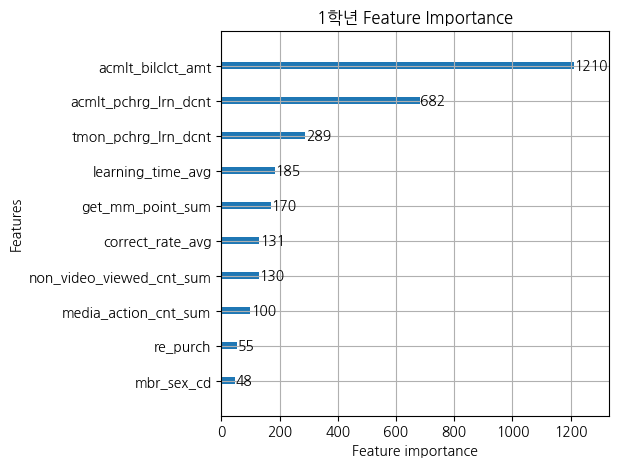

[Train] 2학년, 이탈: 733, 미이탈: 47267
[Test] 2학년, 이탈: 199, 미이탈: 11801
[Predict] 2학년, 이탈: 166, 미이탈: 11834
2학년, acc: 0.9944166666666666, precision: 0.8975903614457831, recall: 0.7487437185929648, f1: 0.8164383561643835


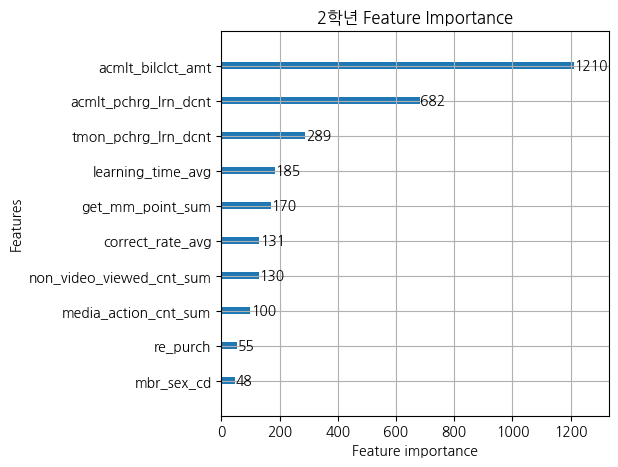

[Train] 3학년, 이탈: 733, 미이탈: 47267
[Test] 3학년, 이탈: 199, 미이탈: 11801
[Predict] 3학년, 이탈: 166, 미이탈: 11834
3학년, acc: 0.9944166666666666, precision: 0.8975903614457831, recall: 0.7487437185929648, f1: 0.8164383561643835


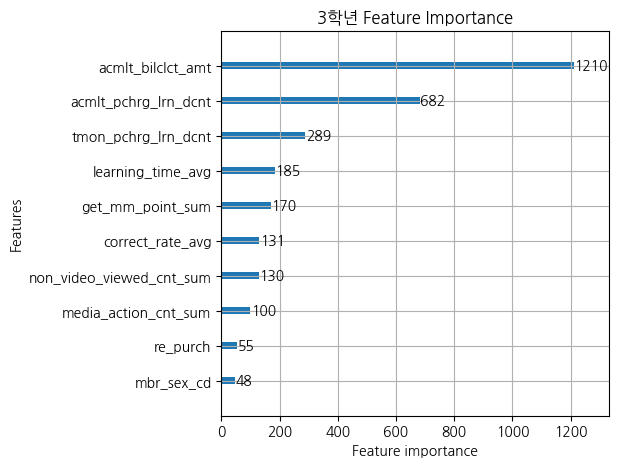

[Train] 4학년, 이탈: 733, 미이탈: 47267
[Test] 4학년, 이탈: 199, 미이탈: 11801
[Predict] 4학년, 이탈: 166, 미이탈: 11834
4학년, acc: 0.9944166666666666, precision: 0.8975903614457831, recall: 0.7487437185929648, f1: 0.8164383561643835


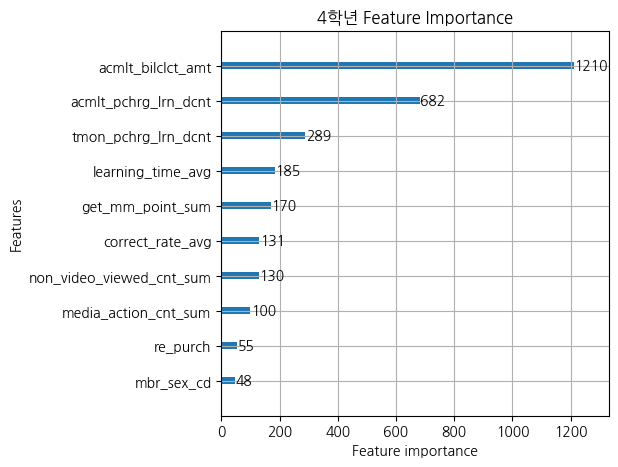

[Train] 5학년, 이탈: 733, 미이탈: 47267
[Test] 5학년, 이탈: 199, 미이탈: 11801
[Predict] 5학년, 이탈: 166, 미이탈: 11834
5학년, acc: 0.9944166666666666, precision: 0.8975903614457831, recall: 0.7487437185929648, f1: 0.8164383561643835


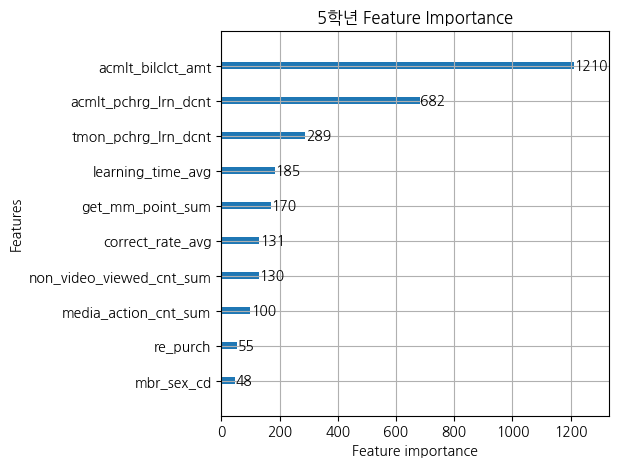

[Train] 6학년, 이탈: 733, 미이탈: 47267
[Test] 6학년, 이탈: 199, 미이탈: 11801
[Predict] 6학년, 이탈: 166, 미이탈: 11834
6학년, acc: 0.9944166666666666, precision: 0.8975903614457831, recall: 0.7487437185929648, f1: 0.8164383561643835


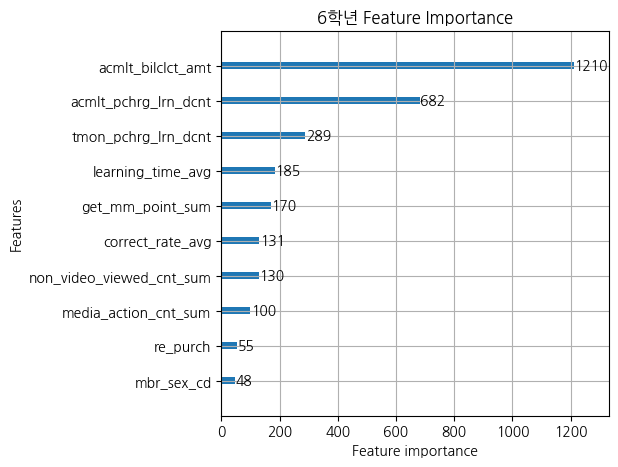

In [206]:
for i in range(1, 7):
    grade_model(df, i)

### 4. 혼돈의 성능 지표 (Confusion Matrix) : Precision, Recall, F1 score

In [207]:
# 1학년 데이터 가져오기
df1 = df[df['grade_sect_cd'] == 1]

X = df1[['mbr_sex_cd', 
        'tmon_pchrg_lrn_dcnt',
        'acmlt_pchrg_lrn_dcnt', 
        'acmlt_bilclct_amt', 
        'correct_rate_avg',
        'learning_time_avg', 
        'media_action_cnt_sum', 
        'non_video_viewed_cnt_sum',
        'get_mm_point_sum', 
        're_purch']]
y = df1['label']

In [209]:
# Train, Test 데이터 분리
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=777)
print('[Train] 이탈: {}, 미이탈: {}'.format(y_train[y_train==1].shape[0], y_train[y_train==0].shape[0]))
print('[Test] 이탈: {}, 미이탈: {}'.format(y_test[y_test==1].shape[0], y_test[y_test==0].shape[0]))

[Train] 이탈: 148, 미이탈: 7852
[Test] 이탈: 26, 미이탈: 1974


In [210]:
# LGBM 학습
lgbm_model = LGBMClassifier(random_state=7, verbose=-1)
lgbm_model.fit(X_train, y_train)

LGBMClassifier(random_state=7, verbose=-1)

In [211]:
# 예측
y_pred = lgbm_model.predict(X_test)
y_pred = list(y_pred)
print('[Predict] 이탈: {}, 미이탈: {}'.format(y_pred.count(1), y_pred.count(0)))

[Predict] 이탈: 21, 미이탈: 1979


In [212]:
# Accuracy
acc = accuracy_score(y_test, y_pred)

In [214]:
# Precision, recall, f1
pre, re, f1, _ = precision_recall_fscore_support(y_test, y_pred, average='binary')
print('acc: {}, precision: {}, recall: {}, f1: {}'.format(acc, pre, re, f1))

acc: 0.9915, precision: 0.7142857142857143, recall: 0.5769230769230769, f1: 0.6382978723404256


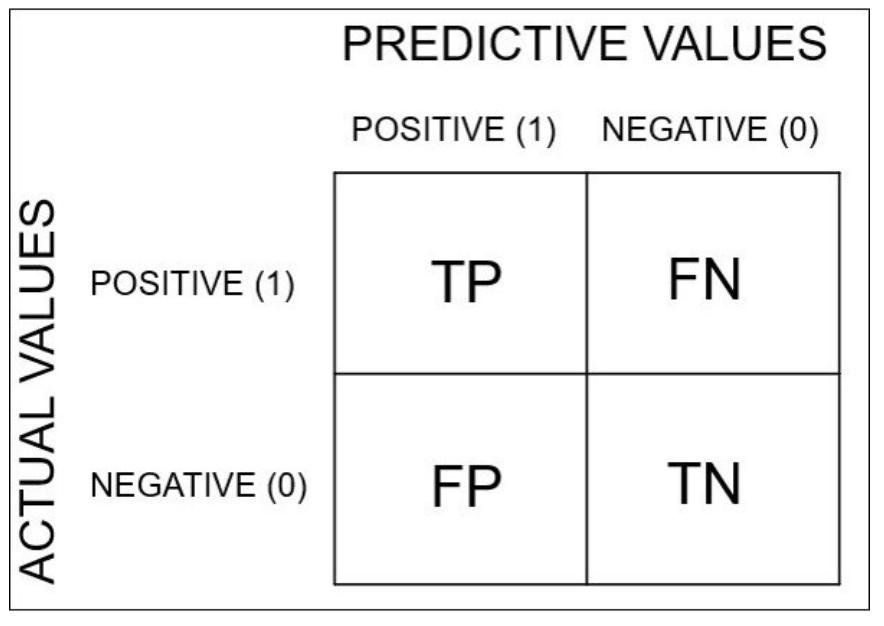

In [220]:
# Confusion Matrix 양식
from IPython.display import Image
Image('./confusion_matrix.png')

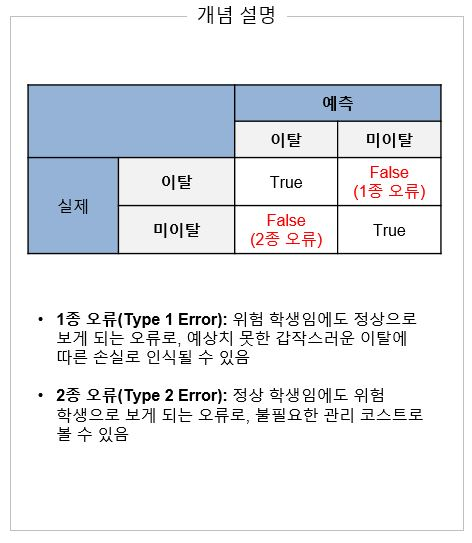

In [221]:
from IPython.display import Image
Image('./error_type.jpg')

,예측: 이탈 (1),예측: 미이탈(0)
실제: 이탈 (1),15,11
실제: 미이탈(0),6,1968


In [236]:
from sklearn.metrics import confusion_matrix

In [241]:
# cmtx 구성
cmtx = pd.DataFrame(
    confusion_matrix(y_test, y_pred, labels = [1,0]),
    index=['실제: 이탈 (1)', '실제: 미이탈(0)'],
    columns=['예측: 이탈 (1)', '예측: 미이탈(0)']
)
cmtx

,예측: 이탈 (1),예측: 미이탈(0)
실제: 이탈 (1),15,11
실제: 미이탈(0),6,1968


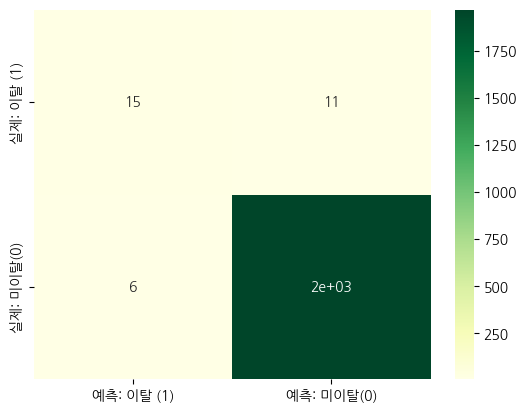

In [242]:
sns.heatmap(cmtx, annot=True, cmap='YlGn')
plt.show()

In [243]:
# cmtx 시각화
import matplotlib.pyplot as plt
import seaborn as sns
import koreanize_matplotlib # 한글 폰트 안 깨지고 사용 가능
# pip install koreanize-matplotlib

In [255]:
# Precision
# TP / (TP+FP)
# pre = 15/21
pre = cmtx.iloc[0, 0] / (cmtx.iloc[0, 0] + cmtx.iloc[1, 0])

# Recall
# TP /(TP+FN)
# rec = 15/26
rec = cmtx.iloc[0, 0] / (cmtx.iloc[0, 0] + cmtx.iloc[0, 1])

# F1 Score
# 2 * (Precision * Recall)/(Precision + Recall)
f1 = 2*(pre*rec) / pre + rec

print(pre, '\n' , rec, '\n' , f1)


0.7142857142857143 
 0.5769230769230769 
 1.7307692307692306
